In [ ]:
import cv2
import numpy as np
import pandas as pd
import os
import glob
from matplotlib import pyplot as plt
from google.colab.patches import cv2_imshow
from PIL import Image
# from pixelmatch.contrib.PIL import pixelmatch
from numpy import asarray
import math
from google.colab import drive

drive.mount('/content/drive')


Mounted at /content/drive


#Images

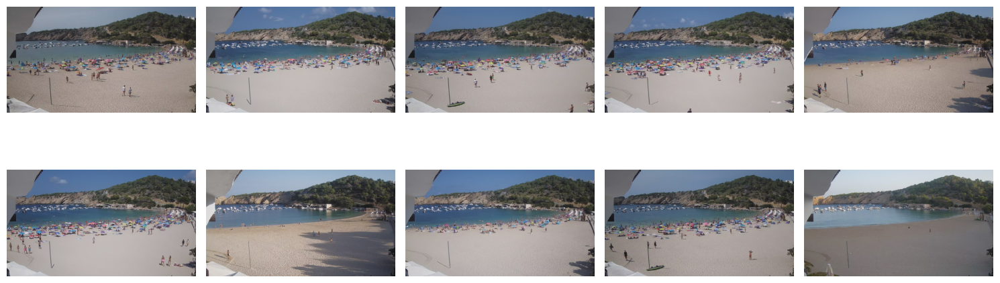

In [ ]:
import os
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


# image_folder = "/content/drive/MyDrive/video and image analysis project1/project1/data"
image_folder = "/content/drive/MyDrive/inputs"

# Get a list of image files in the folder
image_files = [f for f in os.listdir(image_folder) if f.endswith(('.png', '.jpg', '.jpeg'))]

# Set the number of images to display in each row
images_per_row = 5

# Calculate the number of rows needed
num_rows = (len(image_files) + images_per_row - 1) // images_per_row

# Set up the plot with the desired number of rows and columns
fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3 * num_rows))

# Flatten the axes array to iterate easily
axes = axes.flatten()

# Loop through the images and display them
for i, img_file in enumerate(image_files):
    img_path = os.path.join(image_folder, img_file)
    img = mpimg.imread(img_path)

    # Display the image on the current axis
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off axis labels

# Adjust layout to prevent clipping of titles
plt.tight_layout()

# Show the plot
plt.show()


In [ ]:
image_files

['1660575600.jpg',
 '1660557600.jpg',
 '1660568400.jpg',
 '1660564800.jpg',
 '1660550400.jpg',
 '1660561200.jpg',
 '1660546800.jpg',
 '1660554000.jpg',
 '1660572000.jpg',
 '1660543200.jpg']

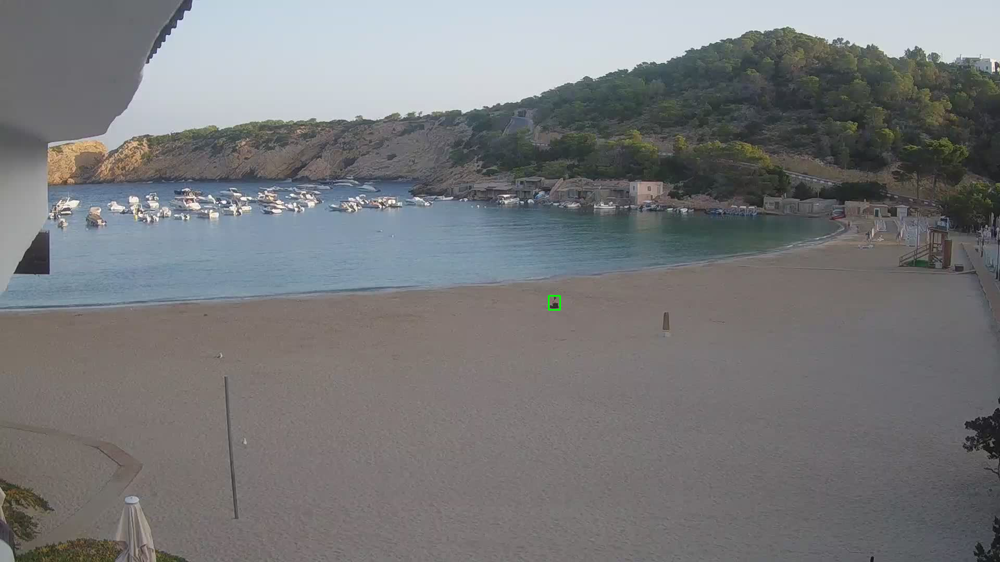

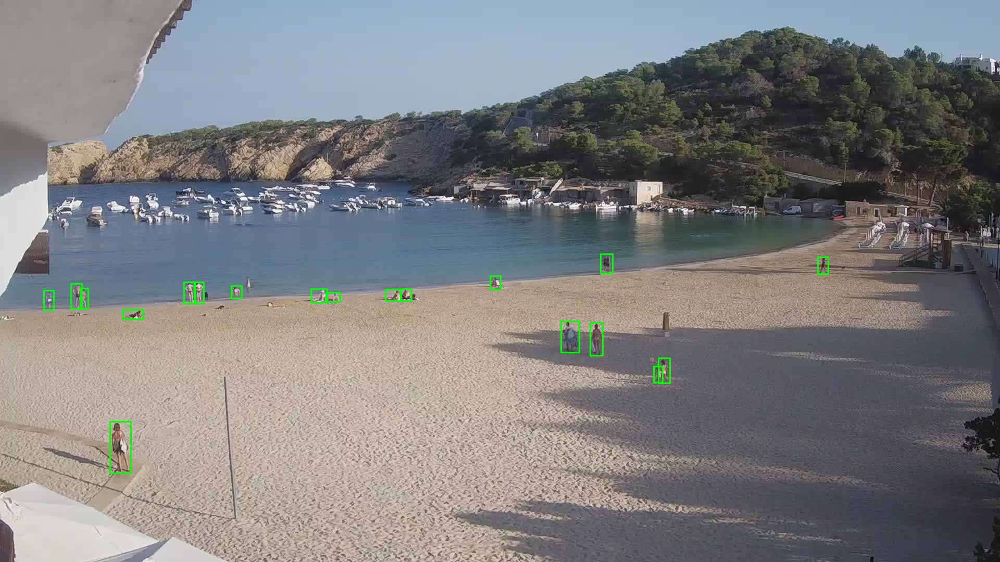

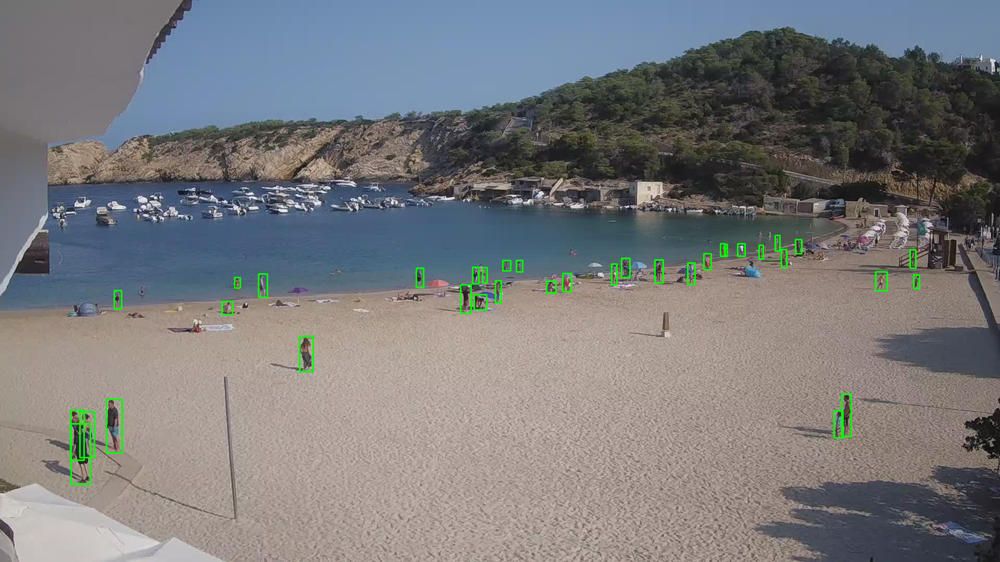

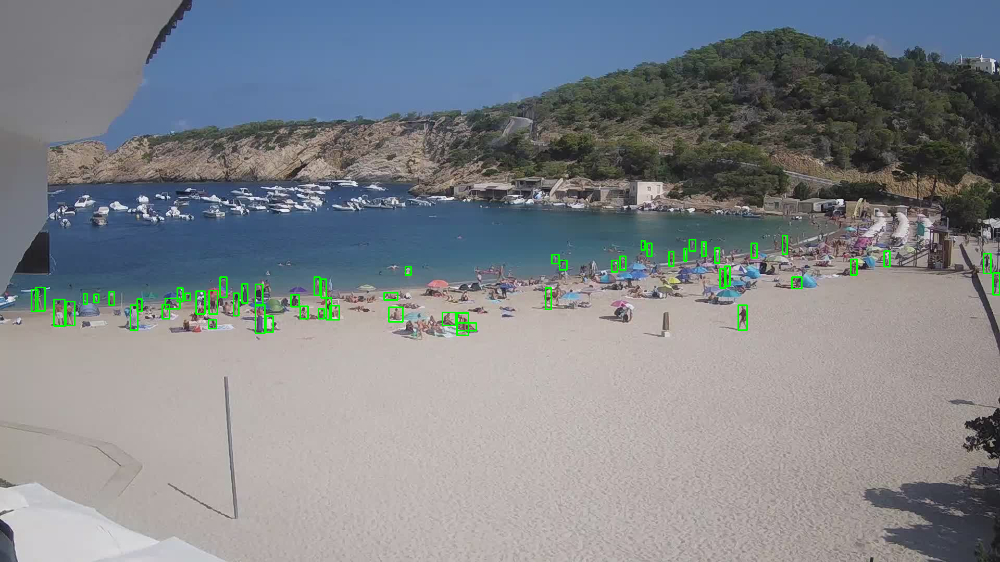

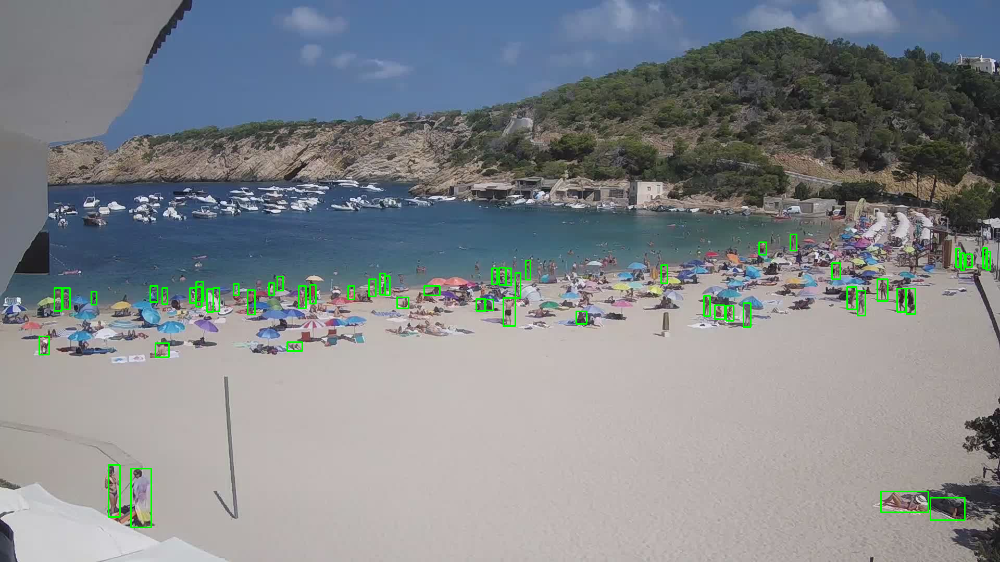

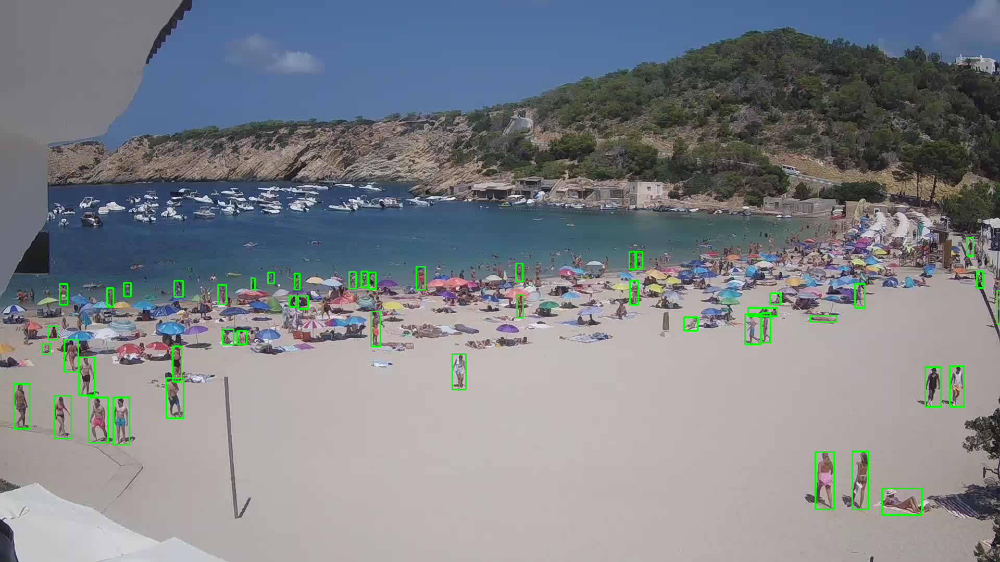

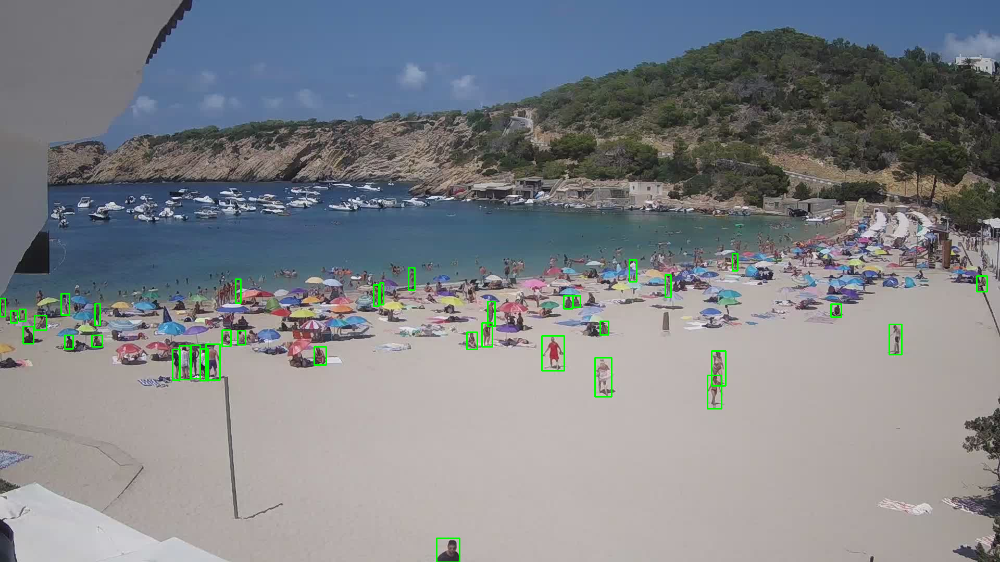

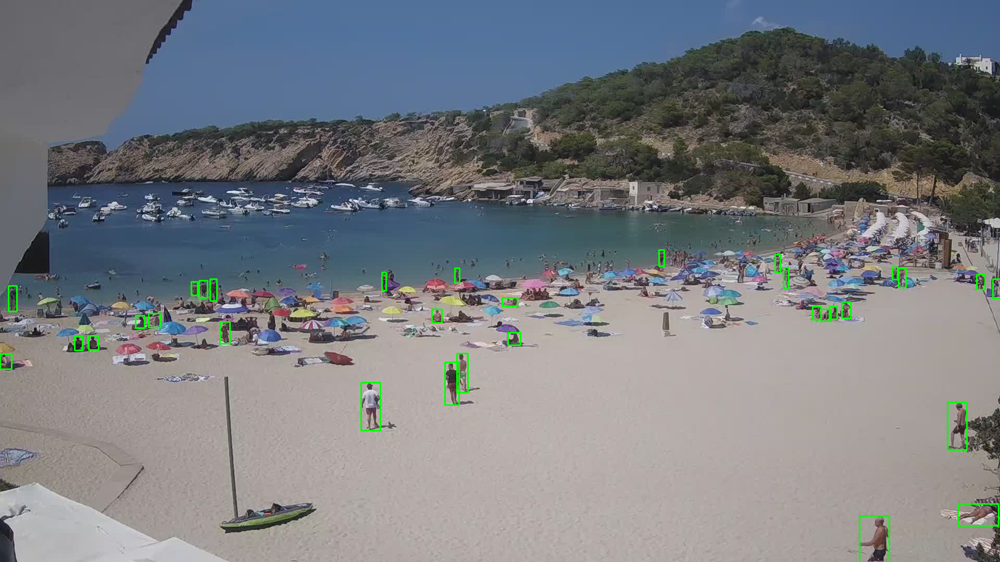

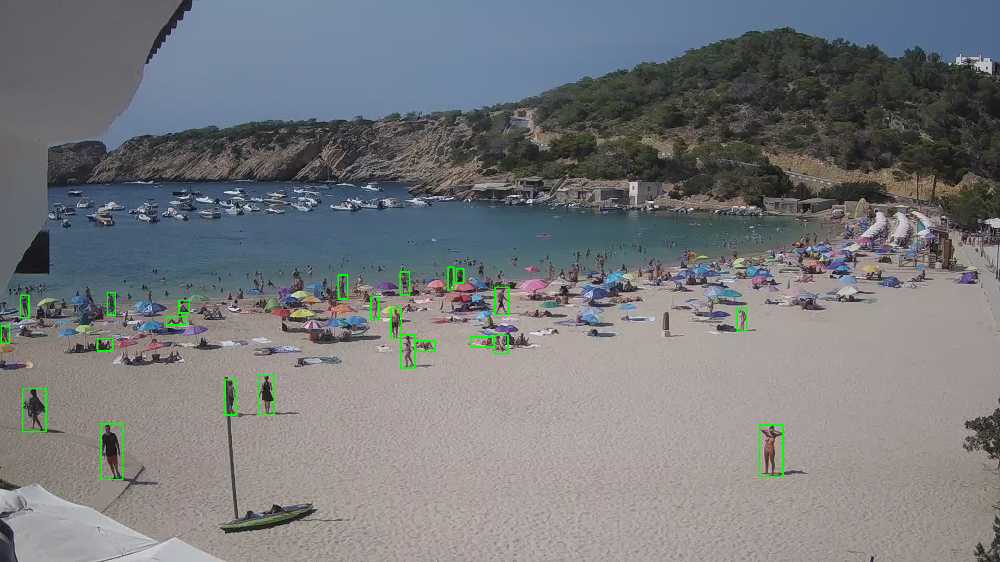

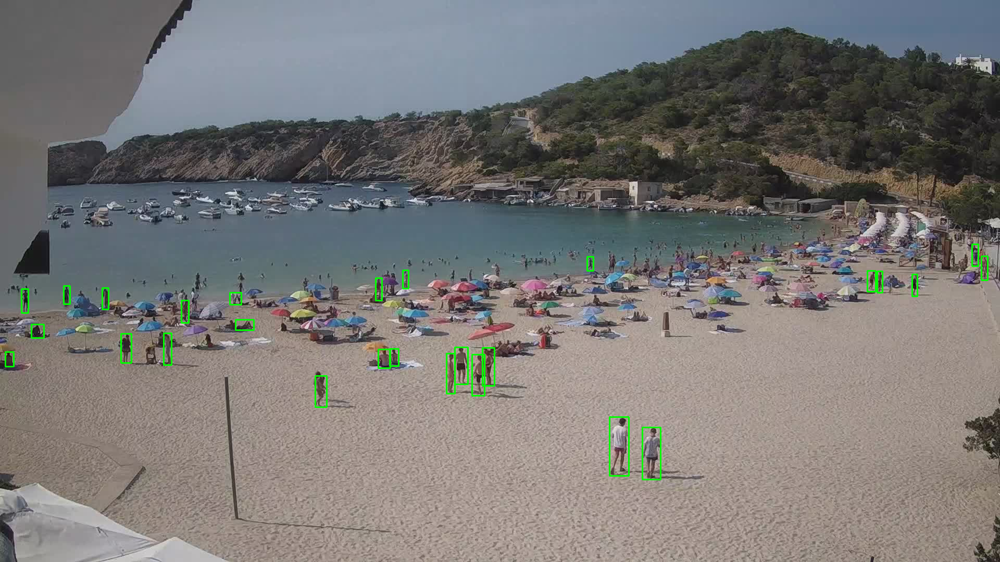

In [ ]:
import cv2
import pandas as pd
import os
from google.colab.patches import cv2_imshow

# Function to display images with annotations
def display_images_with_annotations(csv_file, image_folder):
    # Read CSV file
    df = pd.read_csv(csv_file)

    # Group annotations by image_name
    grouped_annotations = df.groupby('image_name')

    for image_name, group in grouped_annotations:
        # Construct the image path
        image_path = os.path.join(image_folder, image_name)

        # Read the image
        image = cv2.imread(image_path)

        # Iterate through annotations in the group
        for index, row in group.iterrows():
            # Extract bounding box coordinates
            x, y, width, height = int(row['bbox_x']), int(row['bbox_y']), int(row['bbox_width']), int(row['bbox_height'])

            # Draw bounding box on the image
            cv2.rectangle(image, (x, y), (x + width, y + height), (0, 255, 0), 2)

        # Display the image with all bounding boxes
        cv2_imshow(image)

# Set the folder paths
annotations_folder = '/content/drive/MyDrive'
csv_file = os.path.join(annotations_folder, 'labels_my-project-name_2023-12-10-12-33-33.csv')
image_folder = "/content/drive/MyDrive/inputs"

# Display images with annotations
display_images_with_annotations(csv_file, image_folder)


##Manually Created Bounding Boxes

In [ ]:
labels = pd.read_csv(csv_file)
labels.head()

,label_name,bbox_x,bbox_y,bbox_width,bbox_height,image_name,image_width,image_height
0,person,1053,568,22,27,1660543200.jpg,1920,1080
1,person,84,558,19,37,1660546800.jpg,1920,1080
2,person,136,545,21,48,1660546800.jpg,1920,1080
3,person,353,542,22,41,1660546800.jpg,1920,1080
4,person,155,554,14,39,1660546800.jpg,1920,1080


In [ ]:
import pandas as pd
df_labels=labels
# Assuming df_labels is your DataFrame containing bounding box information
# Filter only rows where label_name is 'person'
df_people = df_labels[df_labels['label_name'] == 'person']

# Group by image_name and count the number of people in each image
people_count_per_image = df_people.groupby('image_name').size().reset_index(name='People_Count')

print(people_count_per_image)


       image_name  People_Count
0  1660543200.jpg             1
1  1660546800.jpg            19
2  1660550400.jpg            36
3  1660554000.jpg            57
4  1660557600.jpg            56
5  1660561200.jpg            48
6  1660564800.jpg            38
7  1660568400.jpg            32
8  1660572000.jpg            23
9  1660575600.jpg            27


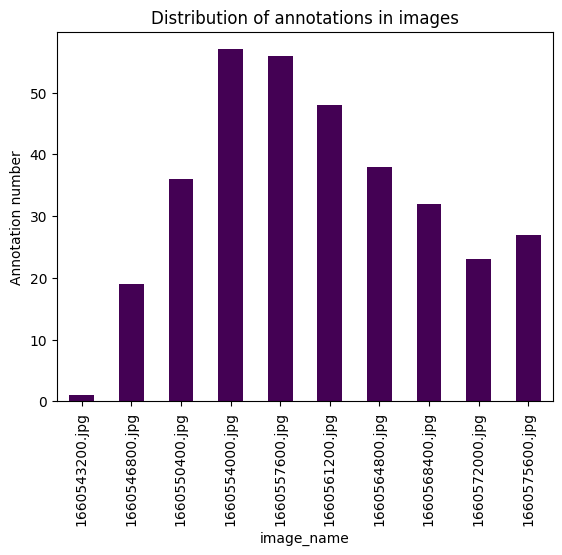

In [ ]:
ax = labels.groupby('image_name')["label_name"].count().plot(kind= 'bar', title="Distribution of annotations in images",stacked=True, colormap='viridis');
ax.set_ylabel("Annotation number");

In [ ]:
import os

def get_all_file_paths(folder_path):
    # Get all files in the specified folder
    all_files = os.listdir(folder_path)

    # Create full paths for each file in the folder
    file_paths = [os.path.join(folder_path, file) for file in all_files]

    return file_paths

# Replace 'your_folder_path' with the path to your specific folder
# folder_path = '/content/drive/MyDrive/video and image analysis project1/project1/data'
folder_path = '/content/drive/MyDrive/inputs'

# Get all file paths in the specified folder
file_paths = get_all_file_paths(folder_path)

# Display the list of file paths
print(file_paths)


['/content/drive/MyDrive/inputs/1660575600.jpg', '/content/drive/MyDrive/inputs/1660557600.jpg', '/content/drive/MyDrive/inputs/1660568400.jpg', '/content/drive/MyDrive/inputs/1660564800.jpg', '/content/drive/MyDrive/inputs/1660550400.jpg', '/content/drive/MyDrive/inputs/1660561200.jpg', '/content/drive/MyDrive/inputs/1660546800.jpg', '/content/drive/MyDrive/inputs/1660554000.jpg', '/content/drive/MyDrive/inputs/1660572000.jpg', '/content/drive/MyDrive/inputs/1660543200.jpg']


In [ ]:
images = []
for f in file_paths:
    i = cv2.imread(f, 1)
    images.append(i)


#image averaging

image averaging: It takes a weighted sum of two images to create a new image. The weights (alpha and beta) determine the contribution of each image to the final result. We decided not to forward with this.

In [ ]:
d_empty_img = images[0]

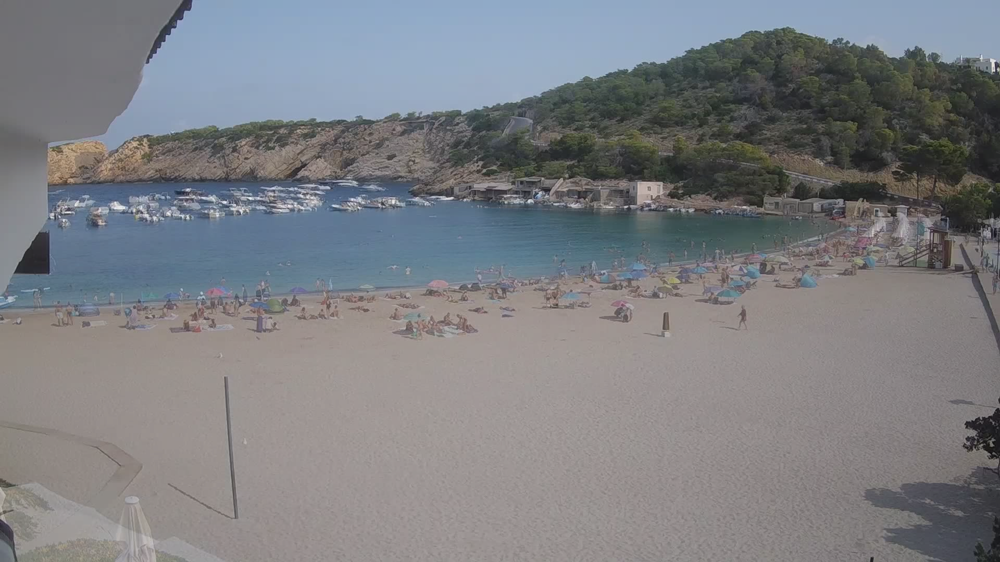

In [ ]:
alpha = 0.5
beta = 1.0 - alpha

avg_image = images[3]
avg_image = cv2.addWeighted(images[3], alpha, d_empty_img, beta, 0.0)
cv2_imshow(avg_image)

#contour detection

In [ ]:
def findContours(image,img_tec,i): #returns image, count and df labels
  img_gray = cv2.cvtColor(img_tec, cv2.COLOR_BGR2GRAY)
  df = pd.DataFrame(columns=['bbox_x','bbox_y',"bbox_width",'bbox_height','image_name'])
  # Find Canny edges
  edged = cv2.Canny(img_gray, 30, 200)
  contours, hierarchy = cv2.findContours(edged,
      cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)
  frame = image.copy()
  count = 0
  for contour in contours:
      # Find bounding rectangles
      x,y,w,h = cv2.boundingRect(contour)
      # Draw the rectangle
      if (h>10 and w >10 and h<100 and w<100) and y>500:
        cv2.rectangle(frame,(x,y),(x+w,y+h),(120,90,250),2)
        count += 1
        new_row = {'bbox_x':x, 'bbox_y':y, 'bbox_width':w, 'bbox_height':h, 'image_name':image_files[i][26:]}
        #append row to the dataframe
        df = df.append(new_row, ignore_index=True)
  return frame, count, df


#Background Subtraction

In [ ]:
# storing the images in data folder
image_files = glob.glob ("/content/drive/MyDrive/inputs/*.jpg")
image_files

['/content/drive/MyDrive/inputs/1660575600.jpg',
 '/content/drive/MyDrive/inputs/1660557600.jpg',
 '/content/drive/MyDrive/inputs/1660568400.jpg',
 '/content/drive/MyDrive/inputs/1660564800.jpg',
 '/content/drive/MyDrive/inputs/1660550400.jpg',
 '/content/drive/MyDrive/inputs/1660561200.jpg',
 '/content/drive/MyDrive/inputs/1660546800.jpg',
 '/content/drive/MyDrive/inputs/1660554000.jpg',
 '/content/drive/MyDrive/inputs/1660572000.jpg',
 '/content/drive/MyDrive/inputs/1660543200.jpg']

blur_kernel_size: (5, 5)   bin_sizes: [0, 51, 102, 153, 204, 255]


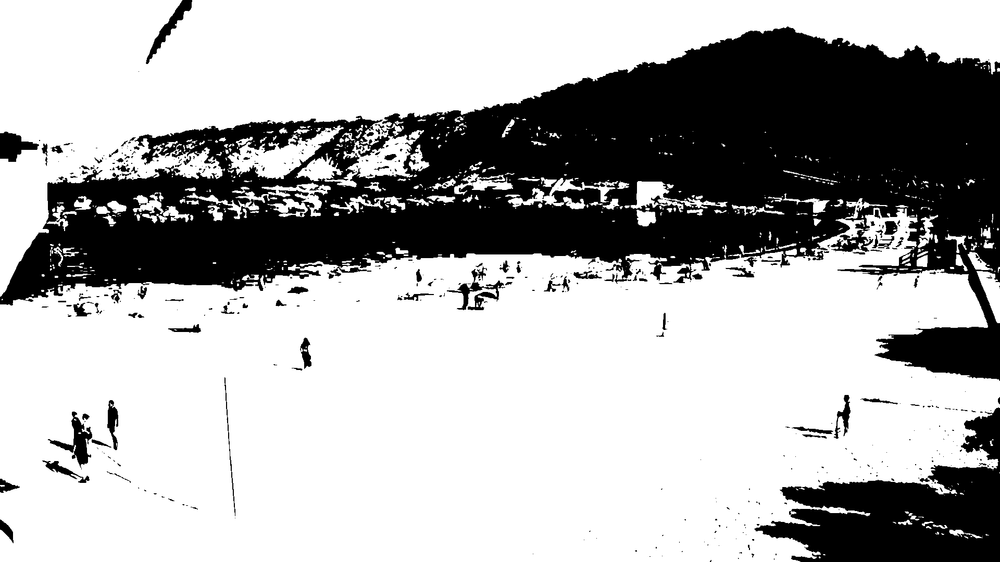

blur_kernel_size: (5, 5)   bin_sizes: [0, 64, 128, 192, 255]


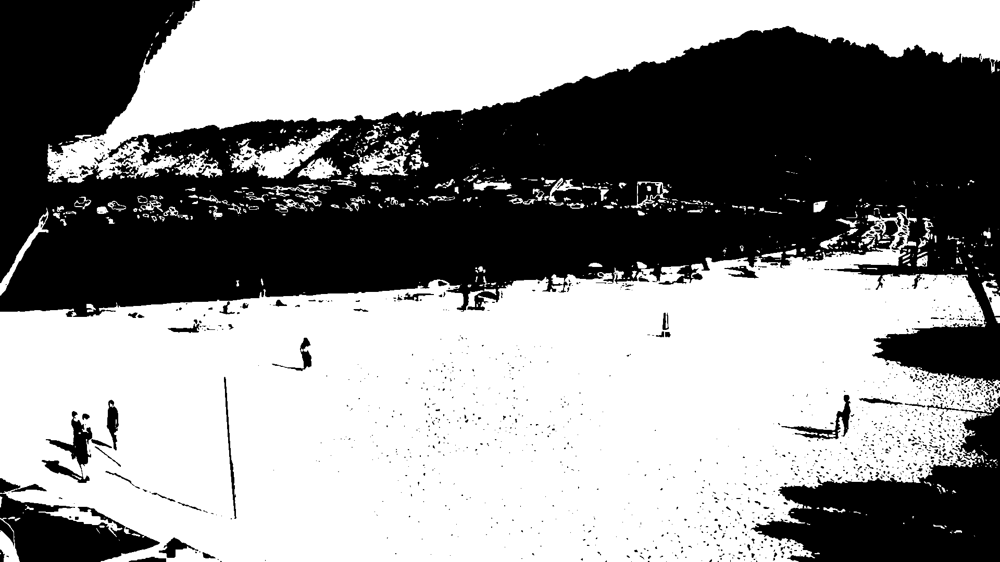

blur_kernel_size: (11, 11)   bin_sizes: [0, 51, 102, 153, 204, 255]


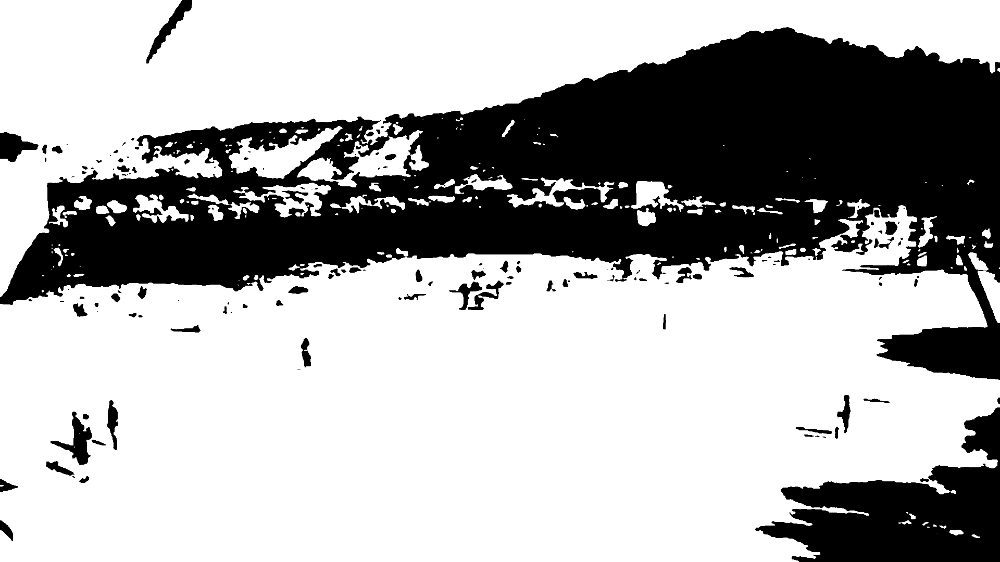

blur_kernel_size: (11, 11)   bin_sizes: [0, 64, 128, 192, 255]


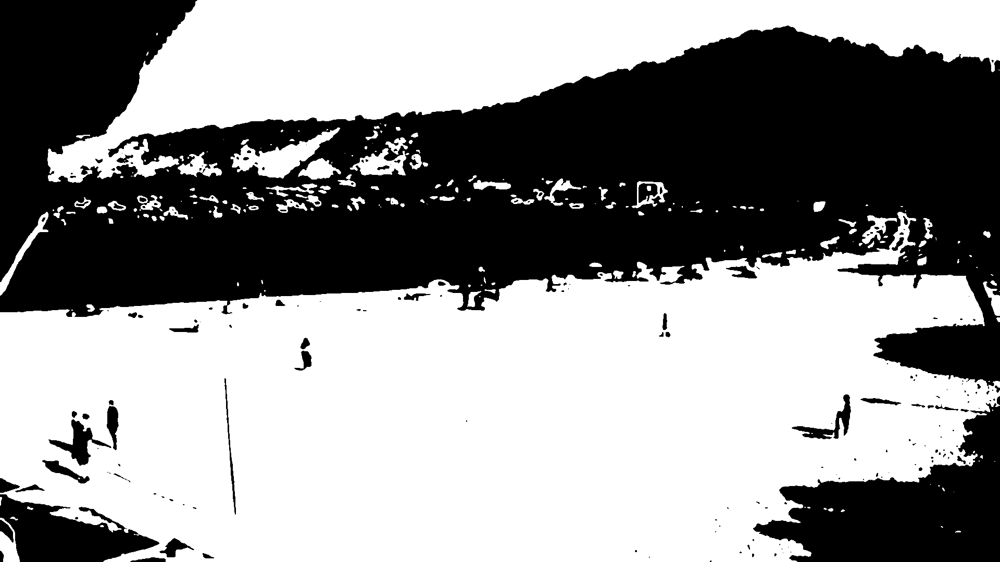

blur_kernel_size: (15, 15)   bin_sizes: [0, 51, 102, 153, 204, 255]


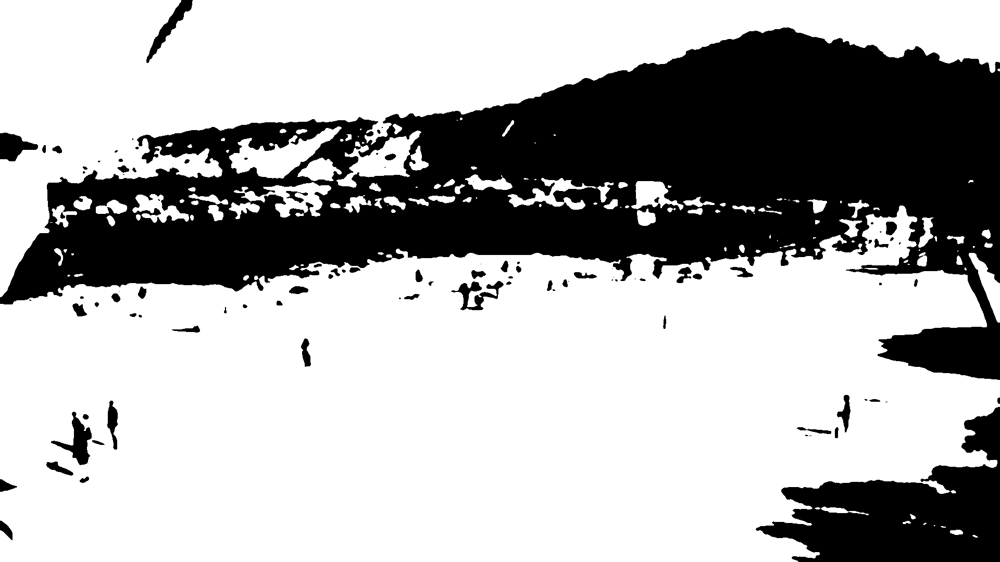

blur_kernel_size: (15, 15)   bin_sizes: [0, 64, 128, 192, 255]


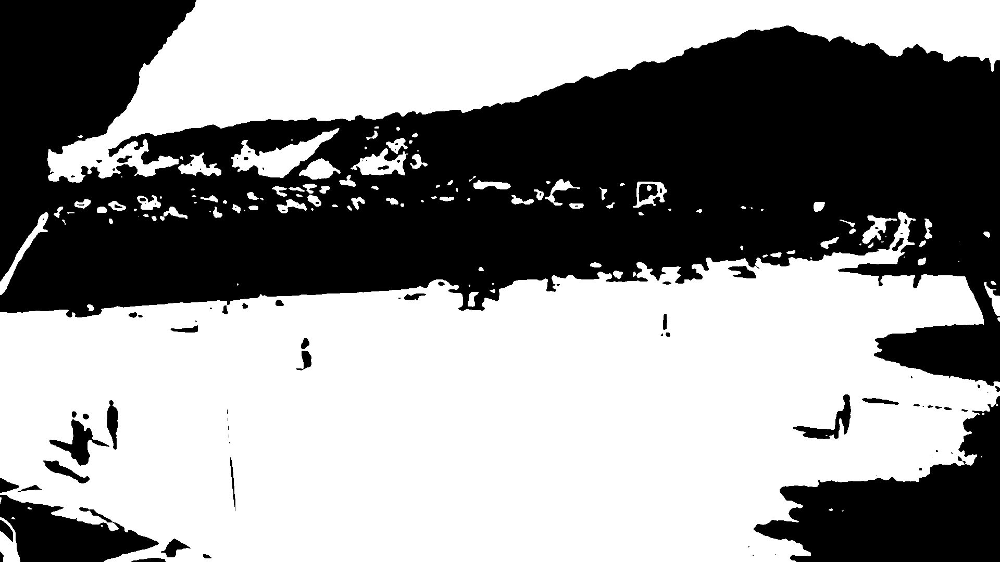

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

def bgremove_with_params(img, blur_kernel_size, bin_sizes):
    # Blur to image to reduce noise
    img_blurred = cv2.GaussianBlur(img, blur_kernel_size, 0)

    # We bin the pixels. Result will be a value 1..5
    bins = np.array(bin_sizes)
    img_blurred[:, :, :] = np.digitize(img_blurred[:, :, :], bins, right=True) * (256 // (len(bin_sizes) - 1))

    # Create single channel grayscale for thresholding
    img_gray = cv2.cvtColor(img_blurred, cv2.COLOR_BGR2GRAY)

    # Perform Otsu thresholding and extract the background.
    _, background = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Convert black and white back into 3 channel grayscale
    background = cv2.cvtColor(background, cv2.COLOR_GRAY2BGR)

    # Perform Otsu thresholding and extract the foreground.
    _, foreground = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    foreground = cv2.bitwise_and(img_blurred, img_blurred, mask=foreground)

    # Combine the background and foreground to obtain our final image
    final_image = cv2.addWeighted(background, 1, foreground, 1, 0)

    return final_image

# Function to display results with different hyperparameters
def display_results_with_params(input_image, blur_kernel_sizes, bin_sizes_list):
    for blur_kernel_size in blur_kernel_sizes:
        for bin_sizes in bin_sizes_list:
            result_image = bgremove_with_params(input_image, blur_kernel_size, bin_sizes)
            #cv2_imshow(f'Result - Blur: {blur_kernel_size}, Bins: {bin_sizes}\n')
            print("blur_kernel_size:",blur_kernel_size,"  bin_sizes:",bin_sizes)
            cv2_imshow(result_image)

# Example usage
input_image = cv2.imread(file_paths[4])

# Hyperparameter options
blur_kernel_sizes = [(5, 5), (11, 11), (15, 15)]
bin_sizes_list = [[0, 51, 102, 153, 204, 255], [0, 64, 128, 192, 255]]

# Display results for different hyperparameters
display_results_with_params(input_image, blur_kernel_sizes, bin_sizes_list)


blur_kernel_size: (5, 5)   bin_sizes: [0, 51, 102, 153, 204, 255] gave better result

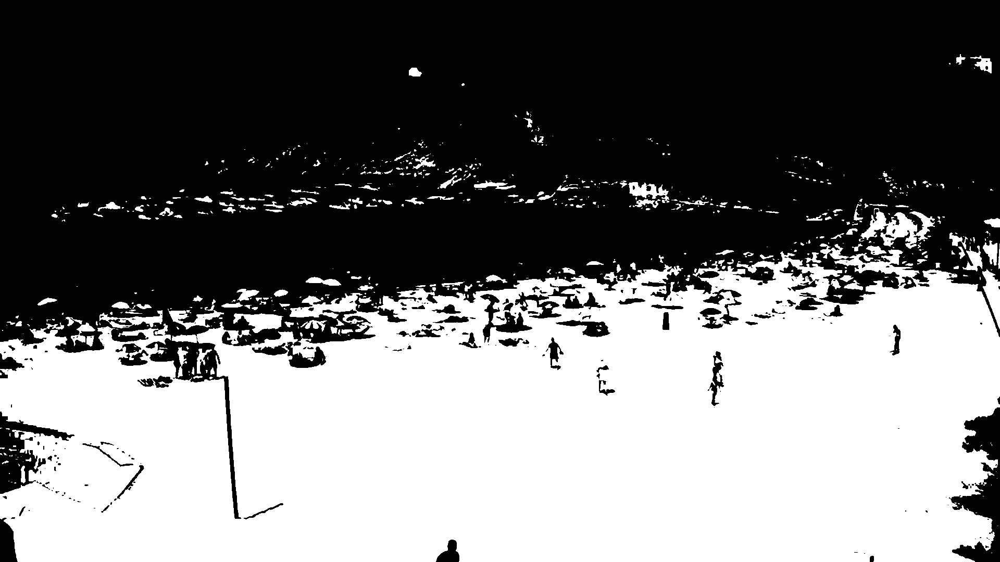

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np

def bgremove2(img):
    # Blur to image to reduce noise
    img = cv2.GaussianBlur(img, (5, 5), 0)

    # We bin the pixels. Result will be a value 1..5 blur_kernel_size: (5, 5)   bin_sizes: [0, 51, 102, 153, 204, 255]
    bins = np.array([0, 51, 102, 153, 204, 255])
    img[:, :, :] = np.digitize(img[:, :, :], bins, right=True) * 51

    # Create single channel grayscale for thresholding
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

    # Perform Otsu thresholding and extract the background.
    _, background = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Convert black and white back into 3 channel grayscale
    background = cv2.cvtColor(background, cv2.COLOR_GRAY2BGR)

    # Perform Otsu thresholding and extract the foreground.
    _, foreground = cv2.threshold(img_gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    foreground = cv2.bitwise_and(img, img, mask=foreground)

    # Combine the background and foreground to obtain our final image
    final_image = cv2.addWeighted(background, 1, foreground, 1, 0)

    return final_image

# Example usage
input_image = cv2.imread(file_paths[3])
result_image = bgremove2(input_image)
cv2_imshow(result_image)


In [ ]:
bg_images = []
for i in range(len(images)):
   bg_images.append(bgremove2(images[i]))

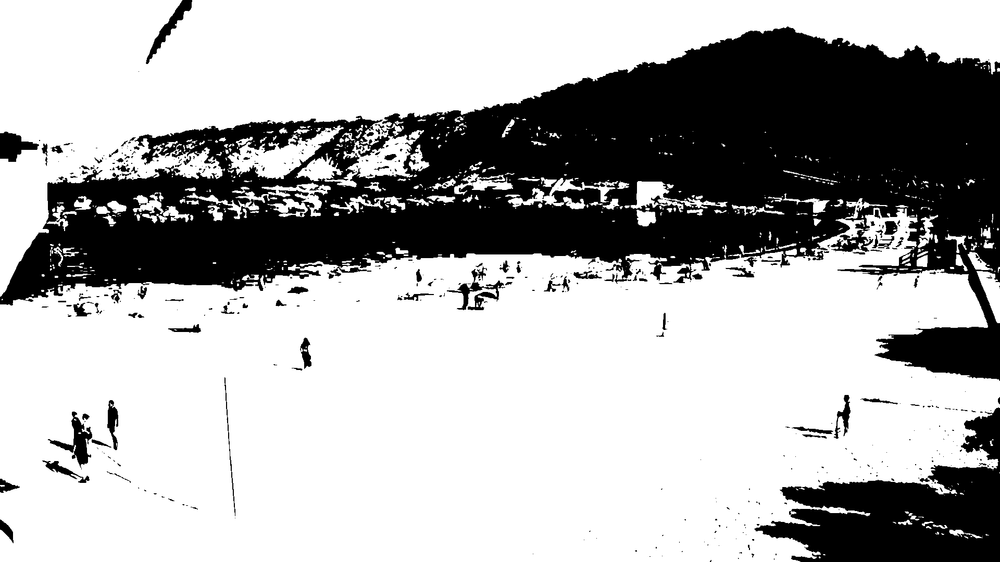

In [ ]:
cv2_imshow(bg_images[4])

<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 0 is 156


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 1 is 165


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 2 is 152


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 3 is 173


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 4 is 85


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 5 is 180


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 6 is 88


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 7 is 159


<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(new_row, ignore_index=True)
<ipython-input-14-f9df577aa5e2>:19: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Us

Predicted number of people for image: 8 is 183
Predicted number of people for image: 9 is 6


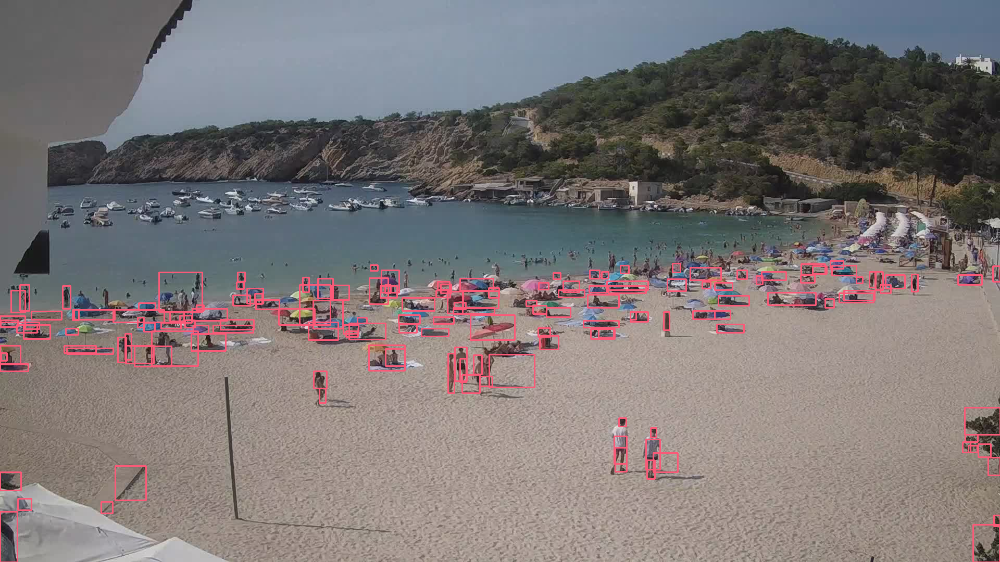

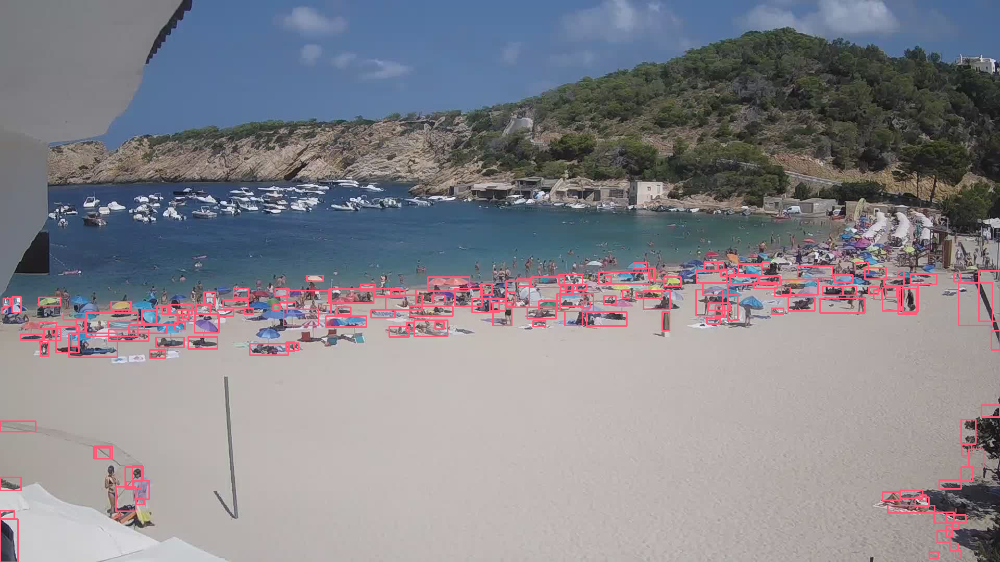

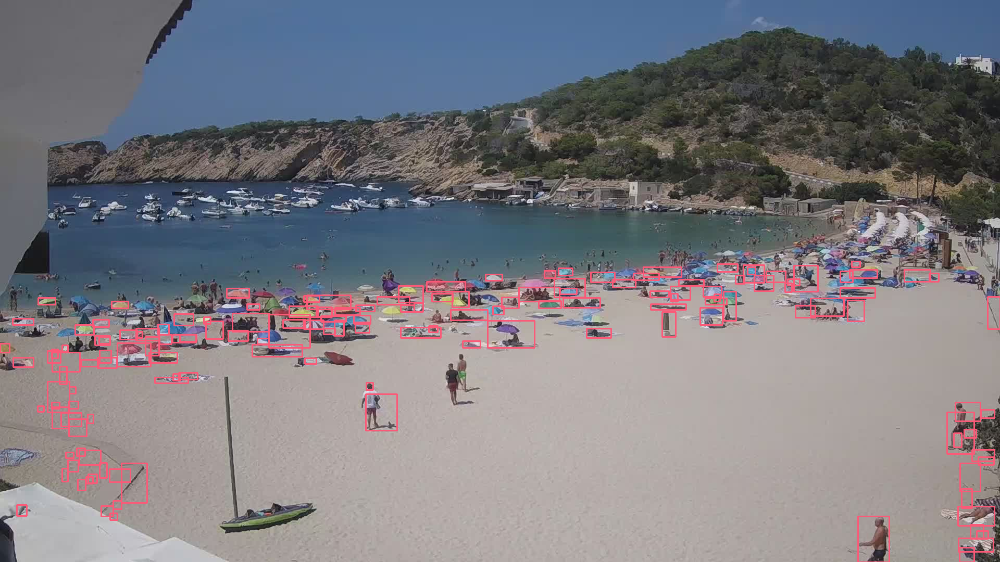

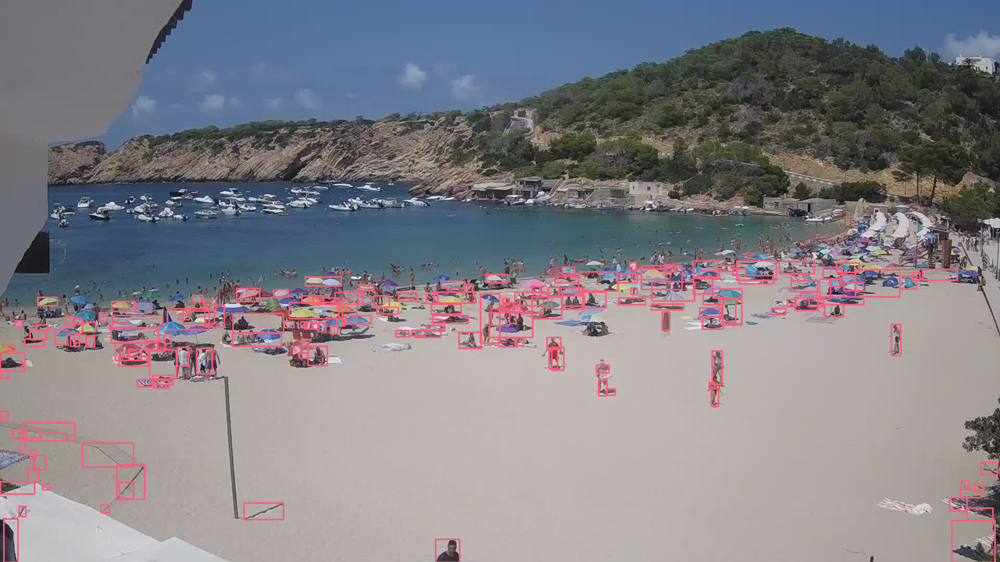

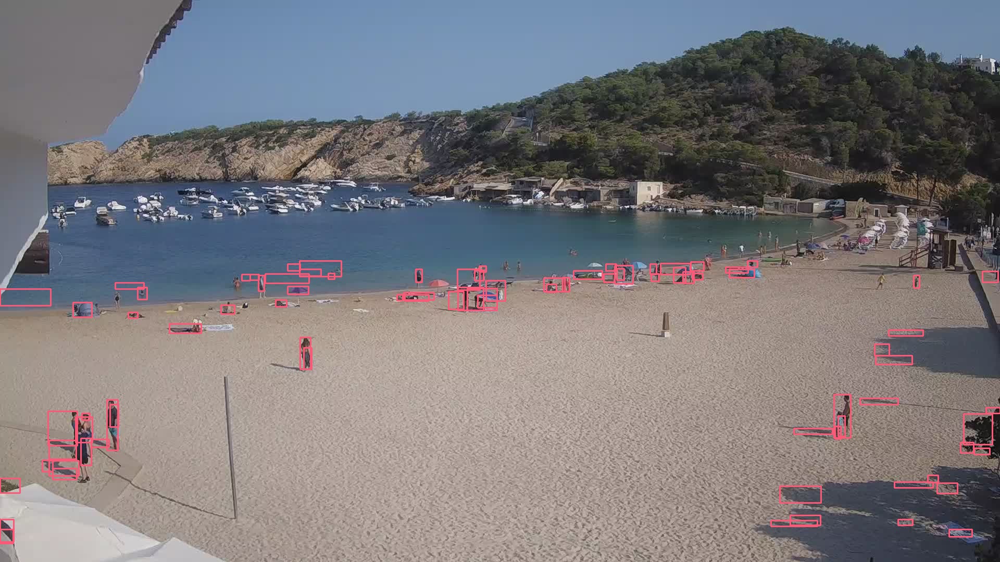

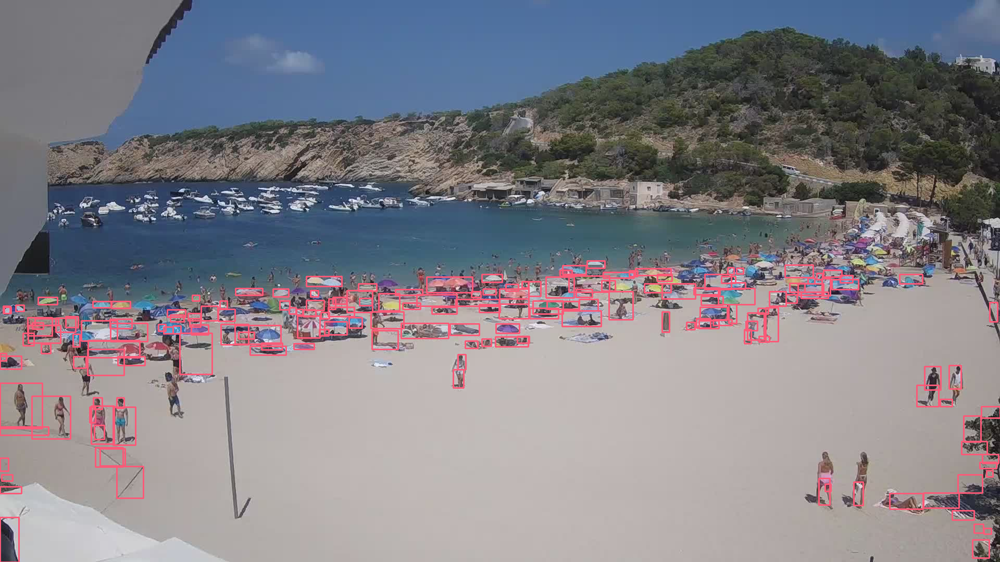

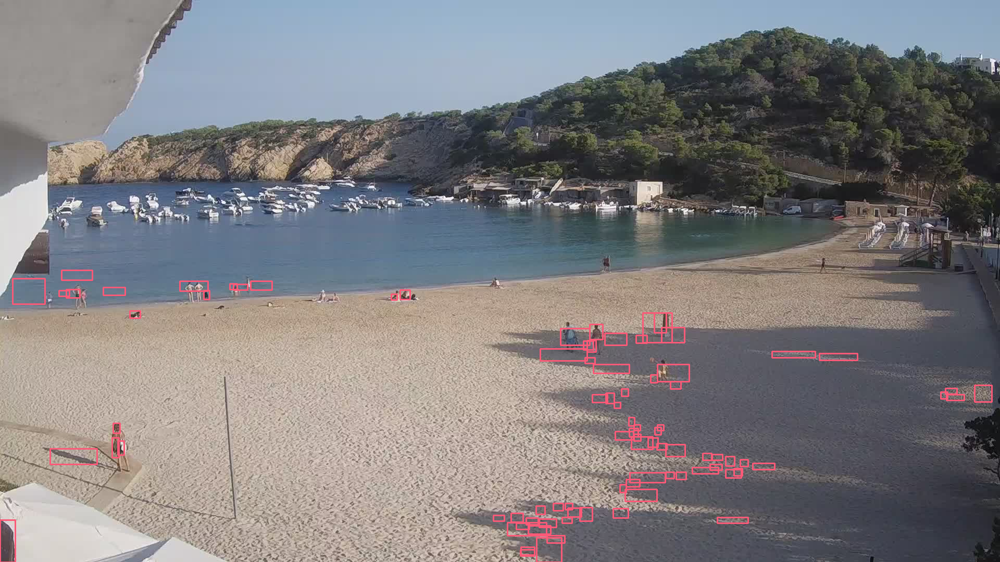

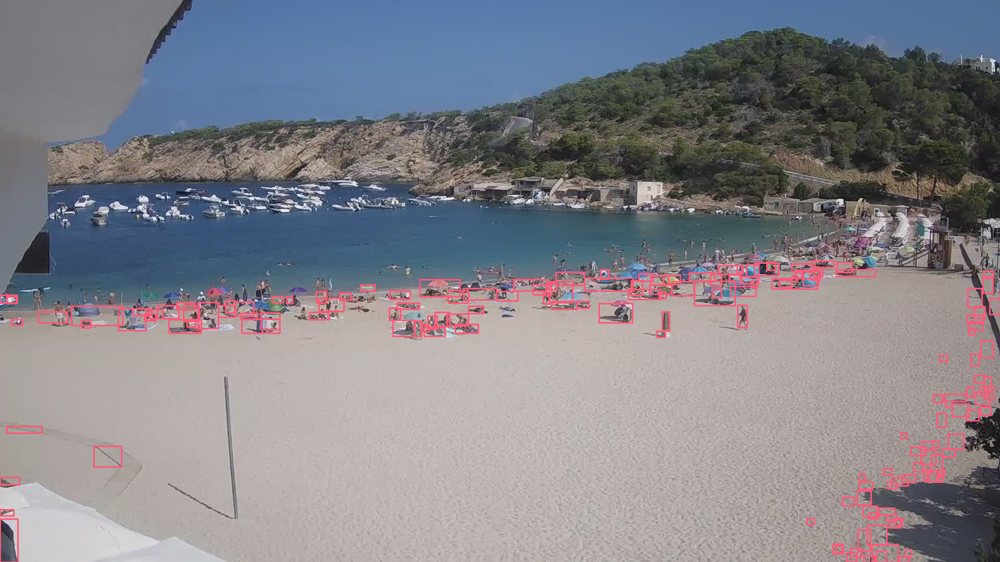

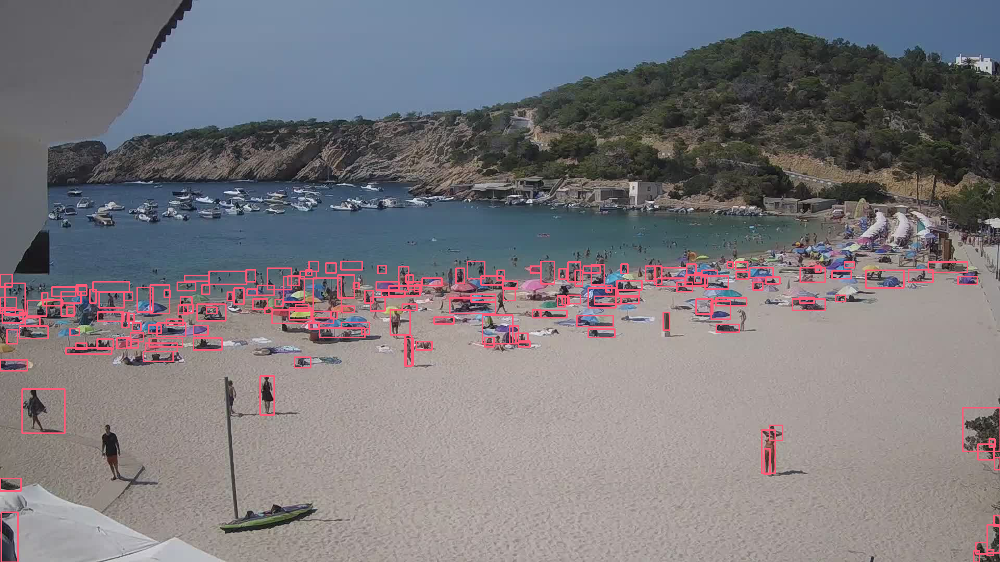

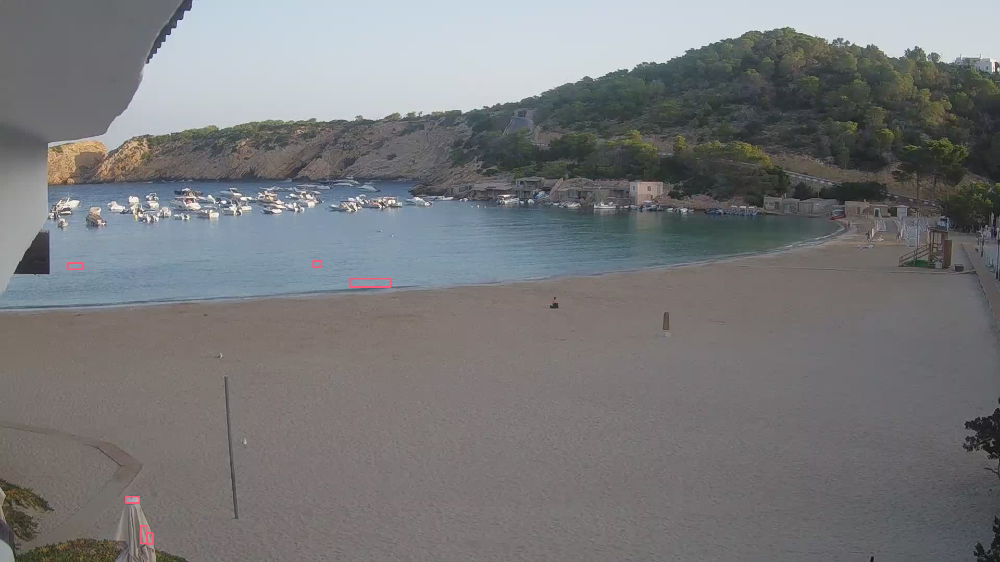

In [ ]:
# For Background Removal Results
df_predicted_BG = pd.DataFrame(columns=['bbox_x','bbox_y',"bbox_width",'bbox_height','image_name'])
res_bg_images = []
for i in range(len(images)):
  frame , count, df = findContours(images[i],bg_images[i],i)
  res_bg_images.append(frame)
  df_predicted_BG = df_predicted_BG.append(df)
  print("Predicted number of people for image: " + str(i) + " is " + str(count) )

#Example
for a in res_bg_images:
  cv2_imshow(a)

In [ ]:
df_predicted_BG

,bbox_x,bbox_y,bbox_width,bbox_height,image_name
0,1868,1008,51,72,uts/1660575600.jpg
1,1908,990,12,21,uts/1660575600.jpg
2,0,983,33,97,uts/1660575600.jpg
3,194,964,22,22,uts/1660575600.jpg
4,34,958,26,22,uts/1660575600.jpg
...,...,...,...,...,...
1,270,1010,11,34,uts/1660543200.jpg
2,241,954,26,12,uts/1660543200.jpg
3,672,535,78,16,uts/1660543200.jpg
4,130,505,29,12,uts/1660543200.jpg


#validation

In [ ]:
df_labels=labels

In [ ]:
image_files

['/content/drive/MyDrive/inputs/1660575600.jpg',
 '/content/drive/MyDrive/inputs/1660557600.jpg',
 '/content/drive/MyDrive/inputs/1660568400.jpg',
 '/content/drive/MyDrive/inputs/1660564800.jpg',
 '/content/drive/MyDrive/inputs/1660550400.jpg',
 '/content/drive/MyDrive/inputs/1660561200.jpg',
 '/content/drive/MyDrive/inputs/1660546800.jpg',
 '/content/drive/MyDrive/inputs/1660554000.jpg',
 '/content/drive/MyDrive/inputs/1660572000.jpg',
 '/content/drive/MyDrive/inputs/1660543200.jpg']

In [ ]:
df_labels['image_name'] = df_labels['image_name'].astype(str)


#save

#vall

In [ ]:
df_predicted_BG

,bbox_x,bbox_y,bbox_width,bbox_height,image_name
0,1868,1008,51,72,uts/1660575600.jpg
1,1908,990,12,21,uts/1660575600.jpg
2,0,983,33,97,uts/1660575600.jpg
3,194,964,22,22,uts/1660575600.jpg
4,34,958,26,22,uts/1660575600.jpg
...,...,...,...,...,...
1,270,1010,11,34,uts/1660543200.jpg
2,241,954,26,12,uts/1660543200.jpg
3,672,535,78,16,uts/1660543200.jpg
4,130,505,29,12,uts/1660543200.jpg


In [ ]:
df_predicted_BG

,bbox_x,bbox_y,bbox_width,bbox_height,image_name
0,1868,1008,51,72,uts/1660575600.jpg
1,1908,990,12,21,uts/1660575600.jpg
2,0,983,33,97,uts/1660575600.jpg
3,194,964,22,22,uts/1660575600.jpg
4,34,958,26,22,uts/1660575600.jpg
...,...,...,...,...,...
1,270,1010,11,34,uts/1660543200.jpg
2,241,954,26,12,uts/1660543200.jpg
3,672,535,78,16,uts/1660543200.jpg
4,130,505,29,12,uts/1660543200.jpg


In [ ]:
# Assuming df_predicted_BG is your DataFrame containing predicted bounding box information
# Filter only rows where label_name is 'person'
df_people_predicted = df_predicted_BG[['bbox_x', 'bbox_y', 'bbox_width', 'bbox_height', 'image_name']]

# Group by image_name and count the number of people in each image
people_count_predicted_per_image = df_people_predicted.groupby('image_name').size().reset_index(name='People_Count_Predicted')

print(people_count_predicted_per_image)


In [ ]:
# Merge the two DataFrames on the 'image_name' column
merged_df = pd.merge(people_count_per_image, people_count_predicted_per_image, on='image_name', how='outer')

# Fill NaN values with 0 (if there are no predictions for a particular image)
merged_df = merged_df.fillna(0)

print(merged_df)


In [ ]:
#HEREEE
import cv2
import pandas as pd

def calculate_precision_boxes(predicted_boxes, actual_boxes):
    df_results = pd.DataFrame(columns=['Precision', 'Sensitivity', 'TP', 'FP', 'numOfActual', 'image_name'])

    for _, actual_box in actual_boxes.iterrows():
        image_name = actual_box['image_name']
        image_actual_boxes = actual_boxes[actual_boxes['image_name'] == image_name]
        image_predicted_boxes = predicted_boxes[predicted_boxes['image_name'] == image_name]

        numOfActual = len(image_actual_boxes)
        TP = 0
        FP = 0

        for _, predicted_box in image_predicted_boxes.iterrows():
            x, y, w, h = predicted_box["bbox_x"], predicted_box["bbox_y"], predicted_box["bbox_width"], predicted_box["bbox_height"]
            drawnRed = False  # To keep track of if already drawn red

            for _, actual_box in image_actual_boxes.iterrows():
                x2, y2, w2, h2 = actual_box["bbox_x"], actual_box["bbox_y"], actual_box["bbox_width"], actual_box["bbox_height"]

                # Some advanced math for box match calculation (all conditions are checked)
                if ((((x2 >= x) and (x2 <= x + w) and (y2 >= y) and (y2 <= y + h)) or
                    ((x2 + w2 >= x) and (x2 + w2 <= x + w) and (y2 + h2 >= y) and (y2 + h2 <= y + h))) or
                    (((x2 + w2 >= x) and (x2 + w2 <= x + w) and (y2 >= y) and (y2 <= y + h)) or
                    ((x2 >= x) and (x2 <= x + w) and (y2 + h2 >= y) and (y2 + h2 <= y + h))) or
                    (((x >= x2) and (x <= x2 + w2) and (y >= y2) and (y <= y2 + h2)) or
                    ((x + w >= x2) and (x + w <= x2 + w2) and (y + h >= y2) and (y + h <= y2 + h2))) or
                    ((x + w >= x2) and (x + w <= x2 + w2) and (y >= y2) and (y <= y2 + h2)) or
                    ((x >= x2) and (x <= x2 + w2) and (y + h >= y2) and (y + h <= y2 + h2)) or
                    ((x <= x2) and (y >= y2) and (x + w >= x2 + w2) and (y + h <= y2 + h2))):
                    drawnRed = True
                    break

            if drawnRed:
                FP += 1
            else:
                TP += 1

        if numOfActual == 0:
            continue  # Skip if there are no actual boxes for the image

        acc = TP / (TP + FP)
        pre = TP / numOfActual
        new_row = {'Precision': round(acc, 2), 'Sensitivity': round(pre, 2), 'TP': TP, 'FP': FP,
                   'numOfActual': numOfActual, 'image_name': image_name}
        df_results = pd.concat([df_results, pd.DataFrame([new_row])], ignore_index=True)

    return df_results

# Example usage
df_results = calculate_precision_boxes(df_predicted_BG, df_labels)
print(df_results)


In [ ]:
import matplotlib.pyplot as plt

# Assuming df_results is your DataFrame
precision_values = df_results['Precision']

plt.hist(precision_values, bins=20, edgecolor='black')
plt.xlabel('Precision')
plt.ylabel('Frequency')
plt.title('Histogram of Precision Values')
plt.show()


In [ ]:
average_precision = df_results['Precision'].mean()
print(f'Average Precision: {average_precision}')

In [ ]:
# Merge the two DataFrames on the 'image_name' column
merged_df = pd.merge(people_count_per_image, people_count_predicted_per_image, on='image_name', how='outer')

# Fill NaN values with 0 (if there are no predictions for a particular image)
merged_df = merged_df.fillna(0)

print(merged_df)


merged_df['MSE'] = np.power(merged_df['People_Count_Predicted'] - merged_df['People_Count'], 2)
# eval_df['error_pct'] = np.divide(merged_df['People_Count_Predicted'], merged_df[''People_Count'']) * 100
print(f"Mean MSE: {merged_df['MSE'].mean()}")

In [ ]:
print(merged_df)
print(f"Mean MSE: {merged_df['MSE'].mean()}")

In [ ]:
#  # draw the final bounding boxes
# for (xA, yA, xB, yB) in detections:
#     cv2.rectangle(image, (xA, yA), (xB, yB), (0, 255, 0), 2)
def union_bounding_box(a: tuple, b: tuple) -> tuple:
    """
    Get the bounding box resulting of the union of two bounding boxes.

    :param a: Tuple defining a bounding box using the format (x, y, width, height)
    :param b: Tuple defining a bounding box using the format (x, y, width, height)
    :return:
    """
    x = min(a[0], b[0])
    y = min(a[1], b[1])
    w = max(a[0]+a[2], b[0]+b[2]) - x
    h = max(a[1]+a[3], b[1]+b[3]) - y
    return x, y, w, h


def intersection_bounding_box(a, b) -> tuple:
    """
    Get the bounding box resulting of the intersection of two bounding boxes.
    If no intersection return a tuple with (0, 0, 0, 0).

    :param a: Tuple defining a bounding box using the format (x, y, width, height)
    :param b: Tuple defining a bounding box using the format (x, y, width, height)
    :return:
    """
    x = max(a[0], b[0])
    y = max(a[1], b[1])
    w = min(a[0]+a[2], b[0]+b[2]) - x
    h = min(a[1]+a[3], b[1]+b[3]) - y
    if w < 0 or h < 0:
        return 0, 0, 0, 0
    else:
        return x, y, w, h


def IoU_bounding_box(bb1, bb2) -> float:
    """
    Get the intersection over union (IoU) metric value of two given bounding boxes.

    :param bb1: Tuple defining a bounding box using the format (x, y, width, height)
    :param bb2: Tuple defining a bounding box using the format (x, y, width, height)
    :return:
    """
    x, y, w, h = union_bounding_box(bb1, bb2)
    area_union = w * h

    x, y, w, h = intersection_bounding_box(bb1, bb2)
    area_intersection = w*h

    if area_union == 0:
        return 0
    else:
        return area_intersection / area_union

In [ ]:
import os
import pandas as pd


# Extract only the filename from the path
df_predicted_BG['image_name'] = df_predicted_BG['image_name'].apply(lambda x: os.path.basename(x))
df_labels['image_name'] = df_labels['image_name'].apply(lambda x: os.path.basename(x))

# Initialize an empty DataFrame to store results
df_results = pd.DataFrame(columns=['image_name', 'bbox_x_pred', 'bbox_y_pred', 'bbox_width_pred', 'bbox_height_pred',
                                   'bbox_x_truth', 'bbox_y_truth', 'bbox_width_truth', 'bbox_height_truth', 'iou'])

# Iterate over each image
for image_name in df_predicted_BG['image_name'].unique():
    # Filter predictions and labels for the current image
    predictions = df_predicted_BG[df_predicted_BG['image_name'] == image_name]
    labels = df_labels[df_labels['image_name'] == image_name]

    # Iterate over each pair of prediction and label
    for _, pred_row in predictions.iterrows():
        for _, label_row in labels.iterrows():
            # Calculate IoU
            x1 = max(pred_row['bbox_x'], label_row['bbox_x'])
            y1 = max(pred_row['bbox_y'], label_row['bbox_y'])
            x2 = min(pred_row['bbox_x'] + pred_row['bbox_width'], label_row['bbox_x'] + label_row['bbox_width'])
            y2 = min(pred_row['bbox_y'] + pred_row['bbox_height'], label_row['bbox_y'] + label_row['bbox_height'])

            intersection_area = max(0, x2 - x1) * max(0, y2 - y1)
            union_area = (pred_row['bbox_width'] * pred_row['bbox_height']) + (label_row['bbox_width'] * label_row['bbox_height']) - intersection_area
            iou = intersection_area / union_area if union_area > 0 else 0

            # Append results to the DataFrame using pd.concat
            df_results = pd.concat([df_results, pd.DataFrame({
                'image_name': [image_name],
                'bbox_x_pred': [pred_row['bbox_x']],
                'bbox_y_pred': [pred_row['bbox_y']],
                'bbox_width_pred': [pred_row['bbox_width']],
                'bbox_height_pred': [pred_row['bbox_height']],
                'bbox_x_truth': [label_row['bbox_x']],
                'bbox_y_truth': [label_row['bbox_y']],
                'bbox_width_truth': [label_row['bbox_width']],
                'bbox_height_truth': [label_row['bbox_height']],
                'iou': [iou]
            })], ignore_index=True)

# Now df_results contains the IoU for all pairs of predicted and ground truth bounding boxes for the same image without merging dataframes


In [ ]:
df_results

,image_name,bbox_x_pred,bbox_y_pred,bbox_width_pred,bbox_height_pred,bbox_x_truth,bbox_y_truth,bbox_width_truth,bbox_height_truth,iou
0,1660575600.jpg,1868,1008,51,72,1170,801,37,113,0.0
1,1660575600.jpg,1868,1008,51,72,1233,821,35,100,0.0
2,1660575600.jpg,1868,1008,51,72,1751,527,10,42,0.0
3,1660575600.jpg,1868,1008,51,72,1684,521,10,41,0.0
4,1660575600.jpg,1868,1008,51,72,1665,520,16,40,0.0
...,...,...,...,...,...,...,...,...,...,...
51535,1660543200.jpg,270,1010,11,34,1053,568,22,27,0.0
51536,1660543200.jpg,241,954,26,12,1053,568,22,27,0.0
51537,1660543200.jpg,672,535,78,16,1053,568,22,27,0.0
51538,1660543200.jpg,130,505,29,12,1053,568,22,27,0.0


In [ ]:
mean_iou_per_image = df_results.groupby('image_name')['iou'].mean()
print(mean_iou_per_image)

image_name
1660543200.jpg    0.000000
1660546800.jpg    0.002549
1660550400.jpg    0.004555
1660554000.jpg    0.001026
1660557600.jpg    0.001477
1660561200.jpg    0.001428
1660564800.jpg    0.001708
1660568400.jpg    0.001054
1660572000.jpg    0.002614
1660575600.jpg    0.003217
Name: iou, dtype: float64
